In [20]:
import pandas as pd 
import numpy as np 
import plotly.express as px
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# 1 description du dataset

In [21]:

files_2014 = ['uber-raw-data-apr14.csv', 'uber-raw-data-may14.csv', 'uber-raw-data-jun14.csv', 'uber-raw-data-jul14.csv', 'uber-raw-data-aug14.csv', 'uber-raw-data-sep14.csv']

data_2014 = pd.DataFrame()
for file in files_2014:
    data = pd.read_csv('uber-trip-data/' + file)
    data_2014 = pd.concat([data_2014, data])

In [22]:
# Basic stats
print("Number of rows : {}".format(data_2014.shape[0]))
print()

print("Display of dataset: ")
display(data_2014.head())
print()

print("Basics statistics: ")
data_desc = data_2014.describe(include='all')
display(data_desc)
print()

print("Percentage of missing values: ")
display(100*data_2014.isnull().sum()/data_2014.shape[0])

Number of rows : 4534327

Display of dataset: 


,Date/Time,Lat,Lon,Base
0,4/1/2014 0:11:00,40.7690,-73.9549,B02512
1,4/1/2014 0:17:00,40.7267,-74.0345,B02512
2,4/1/2014 0:21:00,40.7316,-73.9873,B02512
3,4/1/2014 0:28:00,40.7588,-73.9776,B02512
4,4/1/2014 0:33:00,40.7594,-73.9722,B02512



Basics statistics: 


,Date/Time,Lat,Lon,Base
count,4534327,4.534327e+06,4.534327e+06,4534327
unique,260093,NaN,NaN,5
top,4/7/2014 20:21:00,NaN,NaN,B02617
freq,97,NaN,NaN,1458853
mean,NaN,4.073926e+01,-7.397302e+01,NaN
std,NaN,3.994991e-02,5.726670e-02,NaN
min,NaN,3.965690e+01,-7.492900e+01,NaN
25%,NaN,4.072110e+01,-7.399650e+01,NaN
50%,NaN,4.074220e+01,-7.398340e+01,NaN
75%,NaN,4.076100e+01,-7.396530e+01,NaN



Percentage of missing values: 


Date/Time    0.0
Lat          0.0
Lon          0.0
Base         0.0
dtype: float64

In [23]:
# convert all observations of Date to datetime
data_2014.loc[:,'Date/Time'] = pd.to_datetime(data_2014['Date/Time'])

# sort values by date
data_2014 =data_2014.sort_values(by = 'Date/Time')
data_2014.head()

,Date/Time,Lat,Lon,Base
35537,2014-04-01 00:00:00,40.7188,-73.9863,B02598
326800,2014-04-01 00:00:00,40.7215,-73.9952,B02682
35536,2014-04-01 00:00:00,40.7637,-73.9600,B02598
218799,2014-04-01 00:01:00,40.7355,-73.9966,B02617
326801,2014-04-01 00:02:00,40.7184,-73.9601,B02682


In [24]:
##data_2014['Date/Time'].dt.day_name()

###Create new columns in the dataset:Month Year day day of week

data_2014.loc[:, 'hour'] = data_2014['Date/Time'].dt.hour
data_2014.loc[:, 'Month'] = data_2014['Date/Time'].dt.month
data_2014.loc[:, 'Day'] = data_2014['Date/Time'].dt.day
data_2014.loc[:, 'Day_of_week'] = data_2014['Date/Time'].dt.day_of_week
data_2014.head()

,Date/Time,Lat,Lon,Base,hour,Month,Day,Day_of_week
35537,2014-04-01 00:00:00,40.7188,-73.9863,B02598,0,4,1,1
326800,2014-04-01 00:00:00,40.7215,-73.9952,B02682,0,4,1,1
35536,2014-04-01 00:00:00,40.7637,-73.9600,B02598,0,4,1,1
218799,2014-04-01 00:01:00,40.7355,-73.9966,B02617,0,4,1,1
326801,2014-04-01 00:02:00,40.7184,-73.9601,B02682,0,4,1,1


2. EDA VISUALISATION

2.1 Le nombre de courses par heure

In [6]:
data_2014['hour'].value_counts(normalize =True)

17    0.074143
18    0.071605
16    0.069117
19    0.064952
20    0.062767
21    0.062073
15    0.060751
22    0.053339
14    0.050862
13    0.043199
7     0.042585
8     0.042014
12    0.037591
23    0.037313
11    0.036544
9     0.035279
10    0.035098
6     0.031584
0     0.022900
5     0.018512
1     0.014826
4     0.012180
3     0.010649
2     0.010115
Name: hour, dtype: float64

<AxesSubplot:xlabel='hour', ylabel='count'>

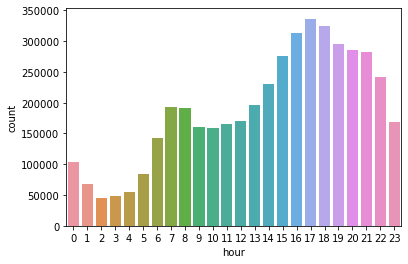

In [7]:
sns.countplot(x="hour", data=data_2014)

On observe que les heures où les courses sont les plus importantes sont comprises dans l'amplitude horaire entre 15 H 00 et 22 h00

2.2 Le pourcentage de courses par mois

In [8]:

pct_change = (data_2014['Month'].value_counts().sort_index().pct_change() * 100).round(1)
pct_change = ('+' + pct_change.astype(str)+ '%').replace('+nan%', '')

/opt/conda/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


<AxesSubplot:xlabel='Month', ylabel='count'>

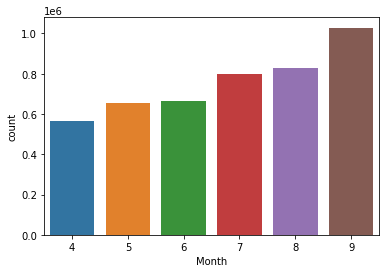

In [9]:
sns.countplot(data_2014['Month'])

[Text(0.5, 1.0, 'Number of rides per month')]

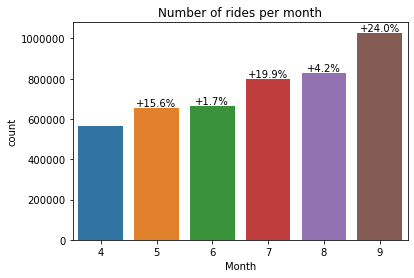

In [10]:
ax = sns.countplot(data=data_2014, x='Month')
plt.ticklabel_format(style='plain', axis='y')
ax.bar_label(ax.containers[0],labels=pct_change)
ax.set(title='Number of rides per month')

2.3 Le pourcentage de course par jour de la semaine

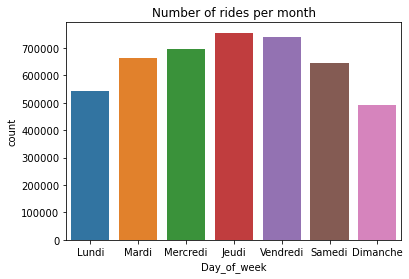

In [11]:
ax = sns.countplot(data=data_2014, x='Day_of_week')
plt.ticklabel_format(style='plain', axis='y')
ax.set(title='Number of rides per month')
ax.set_xticklabels(['Lundi', 'Mardi','Mercredi', 'Jeudi','Vendredi', 'Samedi', 'Dimanche']);

le nombre de courses en semaine sont les plus importantes le jeudi au vendredi

2.4 Representation des observation sur une carte par jour de la semaine

Le jeu de données est assez volumineux, prenons un échantillon d'observation  par jour, que nous pouvons modifier

À l'aide de plotly scatter mapbox, visualisation des points de données sur une carte. Nous pourrons, donc visualiser les courses par jour et par heure dans la journée.


In [12]:
data_1307 = data_2014[(data_2014['Month'] == 7) & (data_2014['Day'] == 13)]

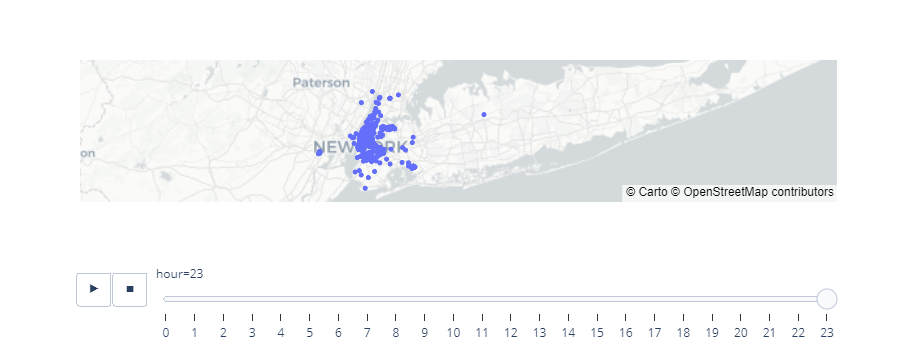

In [13]:
fig = px.scatter_mapbox(
        data_1307, 
        lat="Lat", 
        lon="Lon",
        animation_frame="hour",
        mapbox_style="carto-positron"
)

fig.show()

3. LA METHODE POUR TROUVER LES ZONES LES PLUS CHAUDES

Pour commencer, nous allons utiliser les techniques de Clustering. En effet, tous les lieux de ramassage peuvent être regroupés en différents groupes. On pourra donc utiliser les coordonnées du cluster pour épingler les zones chaudes 

Même si notre travail consiste à  avoir des hot-zones par heure et par jour de la semaine, nous allons commencer petit, en choisissant  un jour à une heure donnée, puis on généralisera l'approche.

De ce fait nous allons utiliser le dbscans et le kmeans.
En fonction de l'alogorithme qui fonctionnera le mieux, on généralisera la méthode en fonction de celui qui sera le plus performant

3.1 Normalisation des données

In [25]:
data_2014.drop(columns=["Date/Time","Base"],inplace=True)

In [26]:
data_07138_11h = data_2014[(data_2014['Month'] == 7) & (data_2014['Day'] == 13) & (data_2014['hour'] ==11)].copy()
data_07138_11h.head()

,Lat,Lon,hour,Month,Day,Day_of_week
122872,40.6454,-73.9444,11,7,13,6
11983,40.7138,-74.0103,11,7,13,6
790537,40.7905,-73.9756,11,7,13,6
122869,40.7208,-74.0038,11,7,13,6
122870,40.7684,-73.8624,11,7,13,6


In [27]:
data_07138_11h.drop(columns=["hour","Month", "Day","Day_of_week"],inplace=True)

In [28]:
from sklearn.preprocessing import StandardScaler
X =  data_07138_11h.copy()
sc= StandardScaler()
X=sc.fit_transform(X)

3.2 Utilsation de la méthode K-means avec Elbow et Silhouette


In [29]:
from sklearn.cluster import KMeans



SELECT OPTIMAL NUMBER OF CLUSTERS K

Elbow

In [30]:
wcss =[]
k = []

for i in range(1,15):
    kmeans = KMeans(n_clusters = i, random_state = 0)
    kmeans.fit(X)
    k.append(i)
    wcss.append(kmeans.inertia_)
    
print(k)
print(wcss)


[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14]
[2150.0, 1598.5899220624096, 1191.4451400241883, 929.383892209675, 714.2096202099826, 562.6867495494242, 470.8587145187972, 380.4151572791583, 328.10873364410423, 284.9458874516892, 245.7338977732628, 221.6812060581559, 199.37439588758951, 172.77313334452148]


In [31]:
# Let's visualize using plotly
import plotly.express as px

# Create DataFrame
wcss_frame = pd.Series(wcss)
k_frame = pd.Series(k)

# Create figure
fig= px.line(x=k_frame,y=wcss_frame)

# Create title and axis labels
fig.update_layout(
    yaxis_title="Inertia",
    xaxis_title="# Clusters",
    title="Inertia per cluster"
)

# Render
#fig.show(renderer="notebook")
fig.show(renderer="iframe") # if using workspac

Silhouette

In [32]:
from sklearn.metrics import silhouette_score

# Computer mean silhouette score
sil = []
k = []

## Careful, you need to start at i=2 as silhouette score cannot accept less than 2 labels 
for i in range (2,11): 
    kmeans = KMeans(n_clusters= i, init = "k-means++", random_state = 0)
    kmeans.fit(X)
    sil.append(silhouette_score(X, kmeans.labels_))#predict(X)
    k.append(i)

print(k)
print(sil)
    

[2, 3, 4, 5, 6, 7, 8, 9, 10]
[0.3679736376980244, 0.39650809251097274, 0.4027469893652326, 0.41236810494355924, 0.4039699108052834, 0.41355862626582945, 0.4182543125332091, 0.43873450331539054, 0.4021289279330226]


In [33]:
# Create a data frame 
cluster_scores=pd.Series(sil)
k_frame = pd.Series(k)

# Create figure
fig = px.line(x=k, y=cluster_scores)

# Add title and axis labels
fig.update_layout(
    yaxis_title="Silhouette Score",
    xaxis_title="# Clusters",
    title="Silhouette Score per cluster"
)

# Render
#fig.show(renderer="notebook")
fig.show(renderer="iframe") # if using work

In [34]:
cluster = KMeans(n_clusters = 6, random_state = 0)
cluster.fit(X)
data_07138_11h['cluster_id'] = cluster.labels_

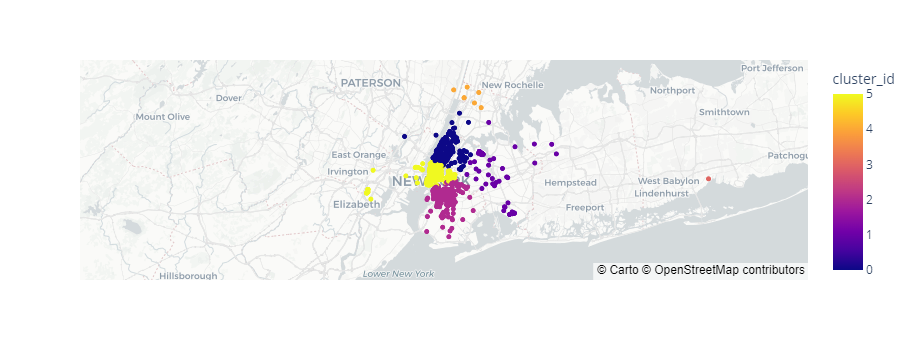

In [35]:
fig = px.scatter_mapbox(
        data_07138_11h, 
        lat="Lat", 
        lon="Lon",
        color="cluster_id",
        mapbox_style="carto-positron"
)

fig.show()

3.3 Utilisation de la méthode DBSCANS

In [28]:
# import DBSCAN from sklearn and numpy
from sklearn.cluster import DBSCAN
import numpy as np

DBSCAN(algorithm='brute', eps=0.2, min_samples=1000)

Découvrons combien de clusters DBSCAN peut créer

In [86]:
# Instanciate DBSCAN 
db = DBSCAN(eps=0.2, min_samples=25, metric="euclidean", algorithm="brute")

# Fit on data 
## No need to normalize data, it already is! 
db.fit(X)

DBSCAN(algorithm='brute', eps=0.2, min_samples=25)

In [87]:
np.unique(db.labels_)

array([-1,  0,  1,  2,  3])

Ajoutez une nouvelle colonne "cluster" à X où chaque observation sera l'étiquette du cluster correspondant.


In [88]:
data_07138_11h['cluster_id2'] = db.labels_


Visualisez tous les clusters sur une carte à l'exception de tous ceux que DBSCAN a considérés comme des valeurs aberrantes

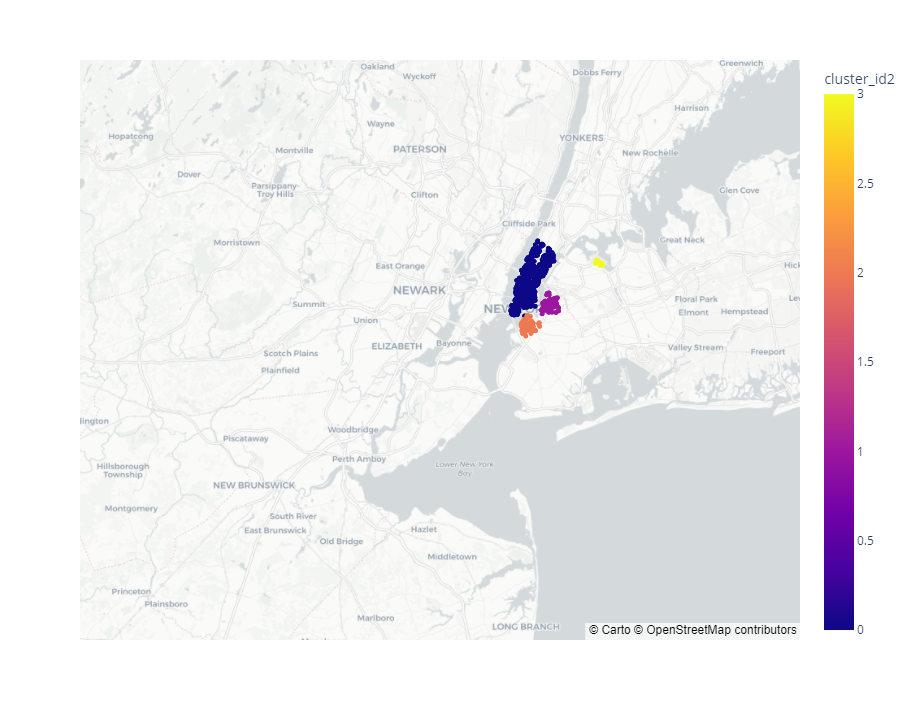

In [89]:
fig = px.scatter_mapbox(
        data_07138_11h[data_07138_11h.cluster_id2 != -1], 
        lat="Lat", 
        lon="Lon",
        color="cluster_id2",
        mapbox_style="carto-positron"
)

fig.show()

In [ ]:
Conclusion : le dbscan est plus representatif que le KMEANS avec moins de outliers

3.4 Généralisation du modèle avec le DBSCANS

In [130]:
results = pd.DataFrame()
for day in range(0,7):
    for hour in range(0,24) :
        data = data_2014[(data_2014['Day_of_week'] == day) & (data_2014['hour'] == hour)].copy()
        data.drop(columns=['Month', 'Day'], inplace=True)
        X = data[['Lat', 'Lon']]
        sc = 
        StandardScaler()
        X = sc.fit_transform(X)
        
        db = DBSCAN(eps=0.2, min_samples=25, metric="euclidean", algorithm="brute")
        db.fit(X)
        
        data['cluster_id'] = list(map(str,db.labels_))
        
        results = pd.concat([results, data])
        

        
results.to_csv(f'clusters/clusters.csv')
        

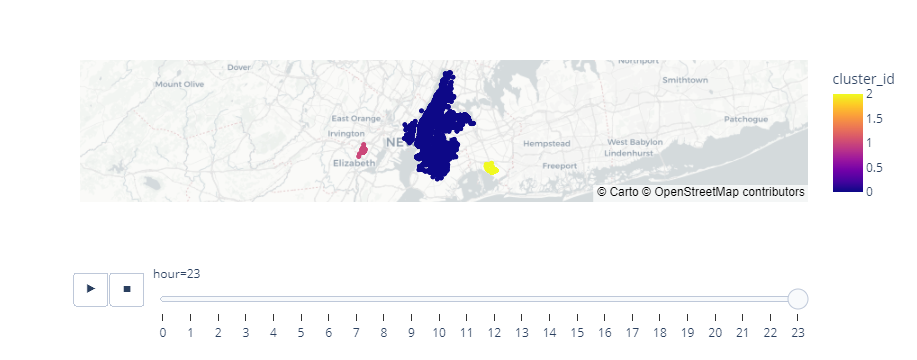

In [131]:
clusters = pd.read_csv('clusters/clusters.csv')
clusters = clusters[clusters['Day_of_week'] == 6]
fig = px.scatter_mapbox(
        clusters[clusters.cluster_id != -1], 
        lat="Lat", 
        lon="Lon",
        color="cluster_id",
        animation_frame="hour",
        mapbox_style="carto-positron"
)

fig.show()